In [1]:
import os, sys
import numpy as np
import torch
import torch.nn.functional as F
from torchmetrics import Accuracy
import hydra
from omegaconf import DictConfig
import wandb
from termcolor import cprint
from tqdm import tqdm

from src.datasets import ThingsMEGDataset
from src.models import BasicConvClassifier
from src.utils import set_seed


@hydra.main(version_base=None, config_path="configs", config_name="config")
def run(args: DictConfig):
    set_seed(args.seed)
    logdir = hydra.core.hydra_config.HydraConfig.get().runtime.output_dir
    
    if args.use_wandb:
        wandb.init(mode="online", dir=logdir, project="MEG-classification")

    # ------------------
    #    Dataloader
    # ------------------
    loader_args = {"batch_size": args.batch_size, "num_workers": args.num_workers}
    
    train_set = ThingsMEGDataset("train", args.data_dir)
    train_loader = torch.utils.data.DataLoader(train_set, shuffle=True, **loader_args)
    val_set = ThingsMEGDataset("val", args.data_dir)
    val_loader = torch.utils.data.DataLoader(val_set, shuffle=False, **loader_args)
    test_set = ThingsMEGDataset("test", args.data_dir)
    test_loader = torch.utils.data.DataLoader(
        test_set, shuffle=False, batch_size=args.batch_size, num_workers=args.num_workers
    )

    # ------------------
    #       Model
    # ------------------
    model = BasicConvClassifier(
        train_set.num_classes, train_set.seq_len, train_set.num_channels
    ).to(args.device)

    # ------------------
    #     Optimizer
    # ------------------
    optimizer = torch.optim.Adam(model.parameters(), lr=args.lr)

    # ------------------
    #   Start training
    # ------------------  
    max_val_acc = 0
    accuracy = Accuracy(
        task="multiclass", num_classes=train_set.num_classes, top_k=10
    ).to(args.device)
      
    for epoch in range(args.epochs):
        print(f"Epoch {epoch+1}/{args.epochs}")
        
        train_loss, train_acc, val_loss, val_acc = [], [], [], []
        
        model.train()
        for X, y, subject_idxs in tqdm(train_loader, desc="Train"):
            X, y = X.to(args.device), y.to(args.device)

            y_pred = model(X)
            
            loss = F.cross_entropy(y_pred, y)
            train_loss.append(loss.item())
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            acc = accuracy(y_pred, y)
            train_acc.append(acc.item())

        model.eval()
        for X, y, subject_idxs in tqdm(val_loader, desc="Validation"):
            X, y = X.to(args.device), y.to(args.device)
            
            with torch.no_grad():
                y_pred = model(X)
            
            val_loss.append(F.cross_entropy(y_pred, y).item())
            val_acc.append(accuracy(y_pred, y).item())

        print(f"Epoch {epoch+1}/{args.epochs} | train loss: {np.mean(train_loss):.3f} | train acc: {np.mean(train_acc):.3f} | val loss: {np.mean(val_loss):.3f} | val acc: {np.mean(val_acc):.3f}")
        torch.save(model.state_dict(), os.path.join(logdir, "model_last.pt"))
        if args.use_wandb:
            wandb.log({"train_loss": np.mean(train_loss), "train_acc": np.mean(train_acc), "val_loss": np.mean(val_loss), "val_acc": np.mean(val_acc)})
        
        if np.mean(val_acc) > max_val_acc:
            cprint("New best.", "cyan")
            torch.save(model.state_dict(), os.path.join(logdir, "model_best.pt"))
            max_val_acc = np.mean(val_acc)
            
    
    # ----------------------------------
    #  Start evaluation with best model
    # ----------------------------------
    model.load_state_dict(torch.load(os.path.join(logdir, "model_best.pt"), map_location=args.device))

    preds = [] 
    model.eval()
    for X, subject_idxs in tqdm(test_loader, desc="Validation"):        
        preds.append(model(X.to(args.device)).detach().cpu())
        
    preds = torch.cat(preds, dim=0).numpy()
    np.save(os.path.join(logdir, "submission"), preds)
    cprint(f"Submission {preds.shape} saved at {logdir}", "cyan")


if __name__ == "__main__":
    run()


usage: ipykernel_launcher.py [--help] [--hydra-help] [--version]
                             [--cfg {job,hydra,all}] [--resolve]
                             [--package PACKAGE] [--run] [--multirun]
                             [--shell-completion] [--config-path CONFIG_PATH]
                             [--config-name CONFIG_NAME]
                             [--config-dir CONFIG_DIR]
                             [--experimental-rerun EXPERIMENTAL_RERUN]
                             [--info [{all,config,defaults,defaults-tree,plugins,searchpath}]]
                             [overrides ...]
ipykernel_launcher.py: error: unrecognized arguments: -f


SystemExit: 2

C:\Users\phant\anaconda3\envs\dlbasics\lib\site-packages\IPython\core\interactiveshell.py:3561: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [1]:
import os, sys
import numpy as np
import torch
import torch.nn.functional as F
from torchmetrics import Accuracy
import hydra
from omegaconf import DictConfig
import wandb
from termcolor import cprint
from tqdm import tqdm

from src.datasets import ThingsMEGDataset
from src.models import BasicConvClassifier
from src.utils import set_seed

def run(args: DictConfig):
    set_seed(args.seed)
    logdir = "outputs"  # 로그 디렉토리 경로 변경
    
    if args.use_wandb:
        wandb.init(mode="online", dir=logdir, project="MEG-classification")

    # ------------------
    #    Dataloader
    # ------------------
    loader_args = {"batch_size": args.batch_size, "num_workers": args.num_workers}
    
    train_set = ThingsMEGDataset("train", args.data_dir)
    train_loader = torch.utils.data.DataLoader(train_set, shuffle=True, **loader_args)
    val_set = ThingsMEGDataset("val", args.data_dir)
    val_loader = torch.utils.data.DataLoader(val_set, shuffle=False, **loader_args)
    test_set = ThingsMEGDataset("test", args.data_dir)
    test_loader = torch.utils.data.DataLoader(
        test_set, shuffle=False, batch_size=args.batch_size, num_workers=args.num_workers
    )

    # ------------------
    #       Model
    # ------------------
    model = BasicConvClassifier(
        train_set.num_classes, train_set.seq_len, train_set.num_channels
    ).to(args.device)

    # ------------------
    #     Optimizer
    # ------------------
    optimizer = torch.optim.Adam(model.parameters(), lr=args.lr)

    # ------------------
    #   Start training
    # ------------------  
    max_val_acc = 0
    accuracy = Accuracy(
        task="multiclass", num_classes=train_set.num_classes, top_k=10
    ).to(args.device)
      
    for epoch in range(args.epochs):
        print(f"Epoch {epoch+1}/{args.epochs}")
        
        train_loss, train_acc, val_loss, val_acc = [], [], [], []
        
        model.train()
        for X, y, subject_idxs in tqdm(train_loader, desc="Train"):
            X, y = X.to(args.device), y.to(args.device)

            y_pred = model(X)
            
            loss = F.cross_entropy(y_pred, y)
            train_loss.append(loss.item())
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            acc = accuracy(y_pred, y)
            train_acc.append(acc.item())

        model.eval()
        for X, y, subject_idxs in tqdm(val_loader, desc="Validation"):
            X, y = X.to(args.device), y.to(args.device)
            
            with torch.no_grad():
                y_pred = model(X)
            
            val_loss.append(F.cross_entropy(y_pred, y).item())
            val_acc.append(accuracy(y_pred, y).item())

        print(f"Epoch {epoch+1}/{args.epochs} | train loss: {np.mean(train_loss):.3f} | train acc: {np.mean(train_acc):.3f} | val loss: {np.mean(val_loss):.3f} | val acc: {np.mean(val_acc):.3f}")
        torch.save(model.state_dict(), os.path.join(logdir, "model_last.pt"))
        if args.use_wandb:
            wandb.log({"train_loss": np.mean(train_loss), "train_acc": np.mean(train_acc), "val_loss": np.mean(val_loss), "val_acc": np.mean(val_acc)})
        
        if np.mean(val_acc) > max_val_acc:
            cprint("New best.", "cyan")
            torch.save(model.state_dict(), os.path.join(logdir, "model_best.pt"))
            max_val_acc = np.mean(val_acc)
            
    
    # ----------------------------------
    #  Start evaluation with best model
    # ----------------------------------
    model.load_state_dict(torch.load(os.path.join(logdir, "model_best.pt"), map_location=args.device))

    preds = [] 
    model.eval()
    for X, subject_idxs in tqdm(test_loader, desc="Validation"):        
        preds.append(model(X.to(args.device)).detach().cpu())
        
    preds = torch.cat(preds, dim=0).numpy()
    np.save(os.path.join(logdir, "submission"), preds)
    cprint(f"Submission {preds.shape} saved at {logdir}", "cyan")


if __name__ == "__main__":
    config_path = "configs"
    config_name = "config"
    with hydra.initialize(config_path=config_path):
        args = hydra.compose(config_name=config_name)
        run(args)

C:\Users\phant\AppData\Local\Temp\ipykernel_46660\2926169427.py:117: UserWarning: 
The version_base parameter is not specified.
Please specify a compatability version level, or None.
Will assume defaults for version 1.1
  with hydra.initialize(config_path=config_path):


Epoch 1/2


Validation: 100%|██████████| 129/129 [00:11<00:00, 10.75it/s]


Epoch 1/2 | train loss: 7.533 | train acc: 0.008 | val loss: 7.505 | val acc: 0.012
New best.
Epoch 2/2


Validation: 100%|██████████| 129/129 [00:08<00:00, 15.06it/s]


Epoch 2/2 | train loss: 7.479 | train acc: 0.013 | val loss: 7.486 | val acc: 0.015
New best.


Validation: 100%|██████████| 129/129 [00:15<00:00,  8.19it/s]


Submission (16432, 1854) saved at outputs


In [2]:
!nvidia-smi

Thu Jun  6 23:44:33 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 531.14                 Driver Version: 531.14       CUDA Version: 12.1     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                      TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf            Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 2060       WDDM | 00000000:01:00.0  On |                  N/A |
| 43%   41C    P0               30W / 184W|    978MiB / 12288MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
import torch

# GPU 사용 가능 여부 확인
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


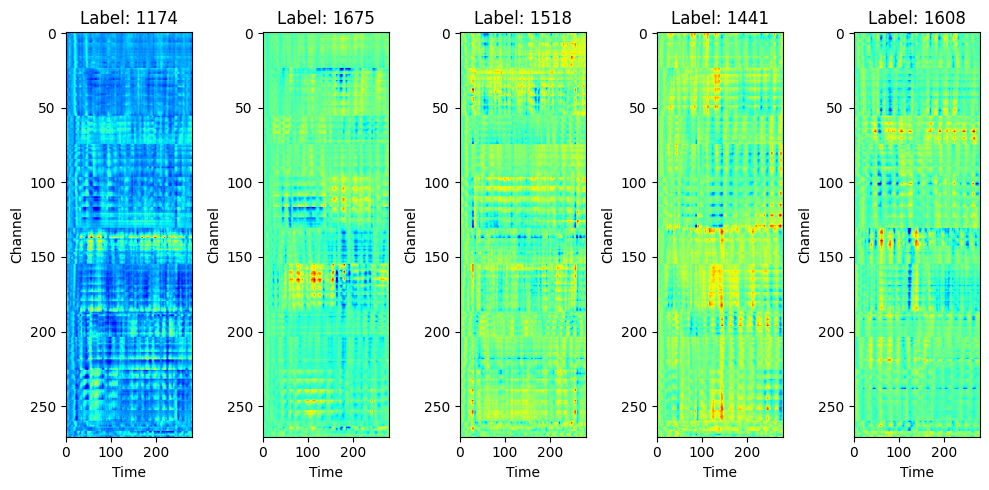

In [4]:
train_set = ThingsMEGDataset("train", args.data_dir)
train_loader = torch.utils.data.DataLoader(train_set, shuffle=True, batch_size=args.batch_size)

# 첫 번째 배치 가져오기
X, y, subject_idxs = next(iter(train_loader))

# 데이터 가시화
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
for i in range(5):  # 배치에서 5개의 샘플 플롯
    plt.subplot(1, 5, i+1)
    plt.imshow(X[i].numpy(), aspect='auto', cmap='jet')
    plt.title(f"Label: {y[i]}")
    plt.xlabel("Time")
    plt.ylabel("Channel")
plt.tight_layout()
plt.show()

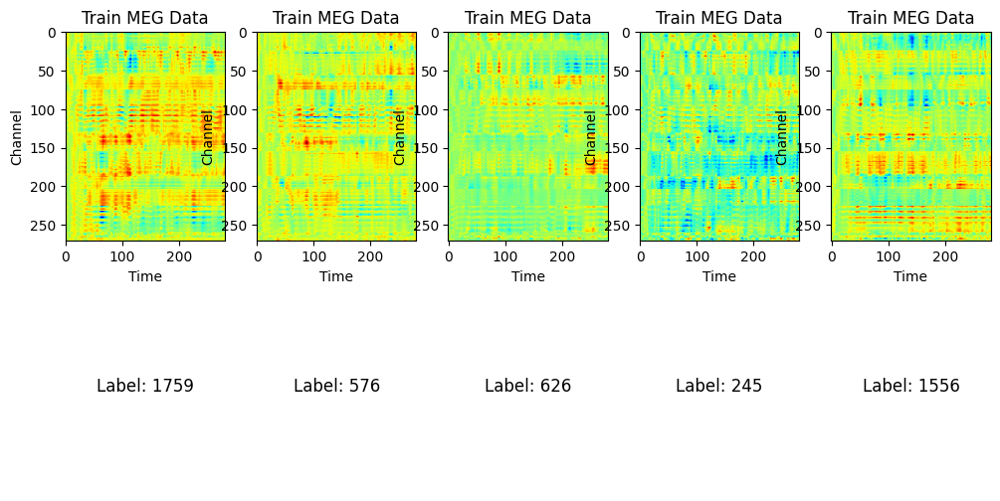

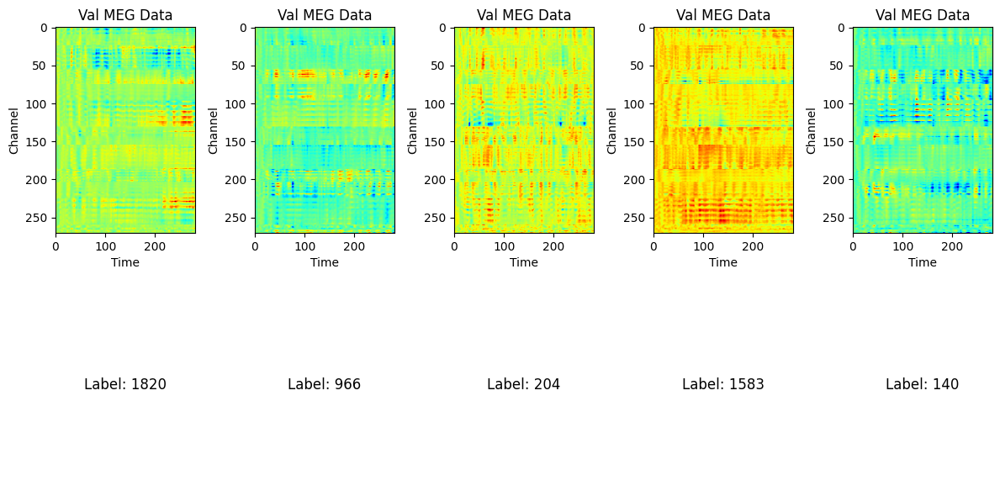

In [6]:
train_set = ThingsMEGDataset("train", args.data_dir)
train_loader = torch.utils.data.DataLoader(train_set, shuffle=False, batch_size=args.batch_size)
val_set = ThingsMEGDataset("val", args.data_dir)
val_loader = torch.utils.data.DataLoader(val_set, shuffle=False, batch_size=args.batch_size)

train_batch = next(iter(train_loader))
val_batch = next(iter(val_loader))

# train 데이터 가시화
plt.figure(figsize=(12, 6))
for i in range(5):  # 배치에서 5개의 샘플 플롯
    plt.subplot(2, 5, i+1)
    plt.imshow(train_batch[0][i].numpy(), aspect='auto', cmap='jet')
    plt.title(f"Train MEG Data")
    plt.xlabel("Time")
    plt.ylabel("Channel")
    
    plt.subplot(2, 5, i+6)
    plt.text(0.5, 0.5, f"Label: {train_batch[1][i]}", ha='center', va='center', fontsize=12)
    plt.axis('off')

# val 데이터 가시화
plt.figure(figsize=(12, 6)) 
for i in range(5):  # 배치에서 5개의 샘플 플롯
    plt.subplot(2, 5, i+1)
    plt.imshow(val_batch[0][i].numpy(), aspect='auto', cmap='jet')
    plt.title(f"Val MEG Data")
    plt.xlabel("Time")
    plt.ylabel("Channel")
    
    plt.subplot(2, 5, i+6)
    plt.text(0.5, 0.5, f"Label: {val_batch[1][i]}", ha='center', va='center', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.show()

# 뇌파 데이터의 전처리

In [ ]:
# 뭔가 잡다하다
import os
import numpy as np
import torch
import mne

def preprocess_data(data, sfreq=200, l_freq=1, h_freq=40):
    preprocessed_data = []
    for X in data:
        X = X.numpy().astype(np.float64)
        X = mne.filter.resample(X, down=4)
        X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
        times = np.arange(X.shape[1]) / sfreq
        X = mne.baseline.rescale(X, times=times, baseline=(None, 0), mode='mean')
        preprocessed_data.append(torch.tensor(X, dtype=torch.float32))
    return torch.stack(preprocessed_data)

def preprocess_and_save(data_dir, splits=["train", "val", "test"]):
    for split in splits:
        data_file = os.path.join(data_dir, f"{split}_X.pt")
        preprocessed_data_file = os.path.join(data_dir, f"{split}_preprocessed_X.pt")
        data = torch.load(data_file)
        preprocessed_data = preprocess_data(data)
        torch.save(preprocessed_data, preprocessed_data_file)

# 전처리 및 저장 실행
data_dir = "data"
preprocess_and_save(data_dir)

class ThingsMEGDataset(torch.utils.data.Dataset):
    def __init__(self, split, data_dir, preprocessed=False):
        self.split = split
        self.data_dir = data_dir
        self.preprocessed = preprocessed
        
        if preprocessed:
            self.data_file = os.path.join(data_dir, f"{split}_preprocessed_X.pt")
        else:
            self.data_file = os.path.join(data_dir, f"{split}_X.pt")
        self.label_file = os.path.join(data_dir, f"{split}_y.pt")
        self.subject_file = os.path.join(data_dir, f"{split}_subject_idxs.pt")
        
        self.data = torch.load(self.data_file)
        self.subject_ids = torch.load(self.subject_file)
        
        if os.path.exists(self.label_file):
            self.labels = torch.load(self.label_file)
        else:
            self.labels = None
        
        self.num_samples = len(self.subject_ids)
        self.num_classes = len(torch.unique(self.labels)) if self.labels is not None else None
        self.seq_len = self.data.shape[2]
        self.num_channels = self.data.shape[1]
        
    def __getitem__(self, idx):
        X = self.data[idx]
        subject_idx = self.subject_ids[idx]
        if self.labels is not None:
            y = self.labels[idx]
            return X, y, subject_idx
        else:
            return X, subject_idx
    
    def __len__(self):
        return self.num_samples


import torch.nn.functional as F
from torchmetrics import Accuracy
import hydra
from omegaconf import DictConfig
import wandb
from termcolor import cprint
from tqdm import tqdm
from src.models import BasicConvClassifier
from src.utils import set_seed

def run(args: DictConfig):
    set_seed(args.seed)
    logdir = "outputs"
    
    if args.use_wandb:
        wandb.init(mode="online", dir=logdir, project="MEG-classification")

    # 데이터셋 로드 시 preprocessed=True로 설정
    loader_args = {"batch_size": args.batch_size, "num_workers": 0}
    
    train_set = ThingsMEGDataset("train", args.data_dir, preprocessed=True)
    train_loader = torch.utils.data.DataLoader(train_set, shuffle=True, **loader_args)
    val_set = ThingsMEGDataset("val", args.data_dir, preprocessed=True)
    val_loader = torch.utils.data.DataLoader(val_set, shuffle=False, **loader_args)
    test_set = ThingsMEGDataset("test", args.data_dir, preprocessed=True)
    test_loader = torch.utils.data.DataLoader(test_set, shuffle=False, **loader_args)

    model = BasicConvClassifier(train_set.num_classes, train_set.seq_len, train_set.num_channels).to(args.device)
    optimizer = torch.optim.Adam(model.parameters(), lr=args.lr)

    max_val_acc = 0
    accuracy = Accuracy(task="multiclass", num_classes=train_set.num_classes, top_k=10).to(args.device)
      
    for epoch in range(args.epochs):
        print(f"Epoch {epoch+1}/{args.epochs}")
        
        train_loss, train_acc, val_loss, val_acc = [], [], [], []
        
        model.train()
        for X, y, subject_idxs in tqdm(train_loader, desc="Train"):
            X, y = X.to(args.device), y.to(args.device)

            y_pred = model(X)
            
            loss = F.cross_entropy(y_pred, y)
            train_loss.append(loss.item())
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            acc = accuracy(y_pred, y)
            train_acc.append(acc.item())

        model.eval()
        for X, y, subject_idxs in tqdm(val_loader, desc="Validation"):
            X, y = X.to(args.device), y.to(args.device)
            
            with torch.no_grad():
                y_pred = model(X)
            
            val_loss.append(F.cross_entropy(y_pred, y).item())
            val_acc.append(accuracy(y_pred, y).item())

        print(f"Epoch {epoch+1}/{args.epochs} | train loss: {np.mean(train_loss):.3f} | train acc: {np.mean(train_acc):.3f} | val loss: {np.mean(val_loss):.3f} | val acc: {np.mean(val_acc):.3f}")
        torch.save(model.state_dict(), os.path.join(logdir, "model_last.pt"))
        if args.use_wandb:
            wandb.log({"train_loss": np.mean(train_loss), "train_acc": np.mean(train_acc), "val_loss": np.mean(val_loss), "val_acc": np.mean(val_acc)})
        
        if np.mean(val_acc) > max_val_acc:
            cprint("New best.", "cyan")
            torch.save(model.state_dict(), os.path.join(logdir, "model_best.pt"))
            max_val_acc = np.mean(val_acc)
            
    model.load_state_dict(torch.load(os.path.join(logdir, "model_best.pt"), map_location=args.device))

    preds = [] 
    model.eval()
    for data in tqdm(test_loader, desc="Validation"):        
        X = data[0] if len(data) == 2 else data
        preds.append(model(X.to(args.device)).detach().cpu())
        
    preds = torch.cat(preds, dim=0).numpy()
    np.save(os.path.join(logdir, "submission"), preds)
    cprint(f"Submission {preds.shape} saved at {logdir}", "cyan")

if __name__ == "__main__":
    config_path = "configs"
    config_name = "config"
    with hydra.initialize(config_path=config_path, version_base=None):
        args = hydra.compose(config_name=config_name)
        run(args)



Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_freq=l_freq, h_freq=h_freq, method='fir', fir_design='firwin', fir_window='hamming', filter_length='auto', verbose=False)
C:\Users\phant\AppData\Local\Temp\ipykernel_38776\116246632.py:11: RuntimeWarning: filter_length (661) is longer than the signal (70), distortion is likely. Reduce filter length or filter a longer signal.
  X = mne.filter.filter_data(X, sfreq=sfreq, l_

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


In [1]:
# Wavelet<- 오류 계속
# Hilbert-Huang Transform (HHT) 적용시도
# 2단계 구성 : Empirical Mode Decomposition (EMD)-> Hilbert Spectral Analysis (HSA)
import os
import numpy as np
import torch
from PyEMD import EMD
from scipy.signal import hilbert
from tqdm import tqdm

def preprocess_data_with_hht(data, fs=200, num_imfs=5):
    preprocessed_data = []
    for X in tqdm(data, desc="Preprocessing data"):
        X = X.numpy().astype(np.float64)
        
        hht_features = []
        for ch in range(X.shape[0]):
            # Generate time array for each channel
            time_array = np.arange(X.shape[1]) / fs
            
            # Empirical Mode Decomposition (EMD)
            emd = EMD()
            imfs = emd.emd(X[ch], time_array)
            
            # Truncate or pad IMFs to a fixed number
            if imfs.shape[0] > num_imfs:
                imfs = imfs[:num_imfs]
            elif imfs.shape[0] < num_imfs:
                pad_width = ((0, num_imfs - imfs.shape[0]), (0, 0))
                imfs = np.pad(imfs, pad_width, mode='constant')
            
            # Hilbert Transform
            analytic_signals = hilbert(imfs)
            amplitudes = np.abs(analytic_signals)
            instantaneous_phases = np.unwrap(np.angle(analytic_signals))
            
            # Calculate Instantaneous Frequency
            instantaneous_frequencies = np.diff(instantaneous_phases) / (2.0 * np.pi) * fs
            
            # Calculate average HHT features for each channel
            avg_amplitude = np.mean(amplitudes, axis=1)
            avg_frequency = np.mean(instantaneous_frequencies, axis=1)
            
            hht_features.append(np.concatenate((avg_amplitude, avg_frequency)))
        
        hht_features = np.stack(hht_features)
        preprocessed_data.append(torch.tensor(hht_features, dtype=torch.float32))
    return torch.stack(preprocessed_data)

def preprocess_and_save_with_hht(data_dir, splits=["train", "val", "test"]):
    for split in splits:
        print(f"Preprocessing {split} data...")
        data_file = os.path.join(data_dir, f"{split}_X.pt")
        preprocessed_data_file = os.path.join(data_dir, f"{split}_preprocessed_X_hht.pt")
        data = torch.load(data_file)
        preprocessed_data = preprocess_data_with_hht(data)
        torch.save(preprocessed_data, preprocessed_data_file)
        print(f"Preprocessed {split} data saved to {preprocessed_data_file}")

# 전처리 및 저장 실행
data_dir = "data"
preprocess_and_save_with_hht(data_dir)

class ThingsMEGDataset(torch.utils.data.Dataset):
    def __init__(self, split, data_dir, preprocessed=False):
        self.split = split
        self.data_dir = data_dir
        self.preprocessed = preprocessed
        
        if preprocessed:
            self.data_file = os.path.join(data_dir, f"{split}_preprocessed_X_hht.pt")
        else:
            self.data_file = os.path.join(data_dir, f"{split}_X.pt")
        self.label_file = os.path.join(data_dir, f"{split}_y.pt")
        self.subject_file = os.path.join(data_dir, f"{split}_subject_idxs.pt")
        
        self.data = torch.load(self.data_file)
        self.subject_ids = torch.load(self.subject_file)
        
        if os.path.exists(self.label_file):
            self.labels = torch.load(self.label_file)
        else:
            self.labels = None
        
        self.num_samples = len(self.subject_ids)
        self.num_classes = len(torch.unique(self.labels)) if self.labels is not None else None
        self.seq_len = self.data.shape[2]
        self.num_channels = self.data.shape[1]
        
    def __getitem__(self, idx):
        X = self.data[idx]
        subject_idx = self.subject_ids[idx]
        if self.labels is not None:
            y = self.labels[idx]
            return X, y, subject_idx
        else:
            return X, subject_idx
    
    def __len__(self):
        return self.num_samples

def run(args: DictConfig):
    set_seed(args.seed)
    logdir = "outputs"  # 로그 디렉토리 경로 변경
    
    if args.use_wandb:
        wandb.init(mode="online", dir=logdir, project="MEG-classification")

    # ------------------
    #    Dataloader
    # ------------------
    loader_args = {"batch_size": args.batch_size, "num_workers": args.num_workers}
    
    train_set = ThingsMEGDataset("train", args.data_dir, preprocessed=True)
    train_loader = torch.utils.data.DataLoader(train_set, shuffle=True, **loader_args)
    val_set = ThingsMEGDataset("val", args.data_dir, preprocessed=True)
    val_loader = torch.utils.data.DataLoader(val_set, shuffle=False, **loader_args)
    test_set = ThingsMEGDataset("test", args.data_dir, preprocessed=True)
    test_loader = torch.utils.data.DataLoader(
        test_set, shuffle=False, batch_size=args.batch_size, num_workers=args.num_workers
    )

    # ------------------
    #       Model
    # ------------------
    model = BasicConvClassifier(
        train_set.num_classes, train_set.seq_len, train_set.num_channels
    ).to(args.device)

    # ------------------
    #     Optimizer
    # ------------------
    optimizer = torch.optim.Adam(model.parameters(), lr=args.lr)

    # ------------------
    #   Start training
    # ------------------  
    max_val_acc = 0
    accuracy = Accuracy(
        task="multiclass", num_classes=train_set.num_classes, top_k=10
    ).to(args.device)
      
    for epoch in range(args.epochs):
        print(f"Epoch {epoch+1}/{args.epochs}")
        
        train_loss, train_acc, val_loss, val_acc = [], [], [], []
        
        model.train()
        for X, y, subject_idxs in tqdm(train_loader, desc="Train"):
            X, y = X.to(args.device), y.to(args.device)

            y_pred = model(X)
            
            loss = F.cross_entropy(y_pred, y)
            train_loss.append(loss.item())
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            acc = accuracy(y_pred, y)
            train_acc.append(acc.item())

        model.eval()
        for X, y, subject_idxs in tqdm(val_loader, desc="Validation"):
            X, y = X.to(args.device), y.to(args.device)
            
            with torch.no_grad():
                y_pred = model(X)
            
            val_loss.append(F.cross_entropy(y_pred, y).item())
            val_acc.append(accuracy(y_pred, y).item())

        print(f"Epoch {epoch+1}/{args.epochs} | train loss: {np.mean(train_loss):.3f} | train acc: {np.mean(train_acc):.3f} | val loss: {np.mean(val_loss):.3f} | val acc: {np.mean(val_acc):.3f}")
        torch.save(model.state_dict(), os.path.join(logdir, "model_last.pt"))
        if args.use_wandb:
            wandb.log({"train_loss": np.mean(train_loss), "train_acc": np.mean(train_acc), "val_loss": np.mean(val_loss), "val_acc": np.mean(val_acc)})
        
        if np.mean(val_acc) > max_val_acc:
            cprint("New best.", "cyan")
            torch.save(model.state_dict(), os.path.join(logdir, "model_best.pt"))
            max_val_acc = np.mean(val_acc)
            
    
    # ----------------------------------
    #  Start evaluation with best model
    # ----------------------------------
    model.load_state_dict(torch.load(os.path.join(logdir, "model_best.pt"), map_location=args.device))

    preds = [] 
    model.eval()
    for X, subject_idxs in tqdm(test_loader, desc="Validation"):        
        preds.append(model(X.to(args.device)).detach().cpu())
        
    preds = torch.cat(preds, dim=0).numpy()
    np.save(os.path.join(logdir, "submission"), preds)
    cprint(f"Submission {preds.shape} saved at {logdir}", "cyan")


if __name__ == "__main__":
    config_path = "configs"
    config_name = "config"
    with hydra.initialize(config_path=config_path):
        args = hydra.compose(config_name=config_name)
        run(args)


Preprocessing train data...


Preprocessing data:   0%|          | 46/65728 [02:33<60:42:15,  3.33s/it]


KeyboardInterrupt: 

In [1]:
# Cupy does not support CUDA 12.1
# We alternatively use PyTorch GPU acceleration -> little bit faster but not impressively
# joblib ver -> 램만 엄청 사용. GPU 설렁설렁
# PyTorch를 활용한 EMD 및 Hilbert Transform 구현 + 데이터를 GPU로 직접 로드하고 처리 
# Cupy 12.1을 찾았다! 사용가능.

import os
import numpy as np
import torch
import cupy as cp
from PyEMD import EMD
from scipy.signal import hilbert
from tqdm import tqdm

def process_channel_gpu(X_ch, fs, num_imfs):
    time_array = cp.arange(X_ch.shape[0]) / fs
    emd = EMD()
    imfs = emd.emd(cp.asnumpy(X_ch), cp.asnumpy(time_array))
    
    if imfs.shape[0] > num_imfs:
        imfs = imfs[:num_imfs]
    elif imfs.shape[0] < num_imfs:
        pad_width = ((0, num_imfs - imfs.shape[0]), (0, 0))
        imfs = np.pad(imfs, pad_width, mode='constant')
    
    analytic_signals = hilbert(imfs)
    amplitudes = cp.abs(cp.asarray(analytic_signals))
    instantaneous_phases = cp.unwrap(cp.angle(cp.asarray(analytic_signals)))
    instantaneous_frequencies = cp.diff(instantaneous_phases) / (2.0 * cp.pi) * fs
    
    avg_amplitude = cp.mean(amplitudes, axis=1)
    avg_frequency = cp.mean(instantaneous_frequencies, axis=1)
    
    return cp.concatenate((avg_amplitude, avg_frequency))

def preprocess_data_with_hht_gpu(data, fs=200, num_imfs=5):
    preprocessed_data = []
    for X in tqdm(data, desc="Preprocessing data"):
        X = X.numpy().astype(np.float64)
        X_gpu = cp.asarray(X)
        
        hht_features = [process_channel_gpu(X_gpu[ch], fs, num_imfs) for ch in range(X_gpu.shape[0])]
        hht_features = cp.stack(hht_features)
        
        preprocessed_data.append(torch.tensor(cp.asnumpy(hht_features), dtype=torch.float32))
    
    return torch.stack(preprocessed_data)

def preprocess_and_save_with_hht_gpu(data_dir, splits=["train", "val", "test"]):
    for split in splits:
        print(f"Preprocessing {split} data...")
        data_file = os.path.join(data_dir, f"{split}_X.pt")
        preprocessed_data_file = os.path.join(data_dir, f"{split}_preprocessed_X_hht.pt")
        data = torch.load(data_file)
        preprocessed_data = preprocess_data_with_hht_gpu(data)
        torch.save(preprocessed_data, preprocessed_data_file)
        print(f"Preprocessed {split} data saved to {preprocessed_data_file}")

# 전처리 및 저장 실행
data_dir = "data"
preprocess_and_save_with_hht_gpu(data_dir)




class ThingsMEGDataset(torch.utils.data.Dataset):
    def __init__(self, split, data_dir, preprocessed=False):
        self.split = split
        self.data_dir = data_dir
        self.preprocessed = preprocessed
        
        if preprocessed:
            self.data_file = os.path.join(data_dir, f"{split}_preprocessed_X_hht.pt")
        else:
            self.data_file = os.path.join(data_dir, f"{split}_X.pt")
        self.label_file = os.path.join(data_dir, f"{split}_y.pt")
        self.subject_file = os.path.join(data_dir, f"{split}_subject_idxs.pt")
        
        self.data = torch.load(self.data_file)
        self.subject_ids = torch.load(self.subject_file)
        
        if os.path.exists(self.label_file):
            self.labels = torch.load(self.label_file)
        else:
            self.labels = None
        
        self.num_samples = len(self.subject_ids)
        self.num_classes = len(torch.unique(self.labels)) if self.labels is not None else None
        self.seq_len = self.data.shape[2]
        self.num_channels = self.data.shape[1]
        
    def __getitem__(self, idx):
        X = self.data[idx]
        subject_idx = self.subject_ids[idx]
        if self.labels is not None:
            y = self.labels[idx]
            return X, y, subject_idx
        else:
            return X, subject_idx
    
    def __len__(self):
        return self.num_samples

def run(args: DictConfig):
    set_seed(args.seed)
    logdir = "outputs"  # 로그 디렉토리 경로 변경
    
    if args.use_wandb:
        wandb.init(mode="online", dir=logdir, project="MEG-classification")

    # ------------------
    #    Dataloader
    # ------------------
    loader_args = {"batch_size": args.batch_size, "num_workers": args.num_workers}
    
    train_set = ThingsMEGDataset("train", args.data_dir, preprocessed=True)
    train_loader = torch.utils.data.DataLoader(train_set, shuffle=True, **loader_args)
    val_set = ThingsMEGDataset("val", args.data_dir, preprocessed=True)
    val_loader = torch.utils.data.DataLoader(val_set, shuffle=False, **loader_args)
    test_set = ThingsMEGDataset("test", args.data_dir, preprocessed=True)
    test_loader = torch.utils.data.DataLoader(
        test_set, shuffle=False, batch_size=args.batch_size, num_workers=args.num_workers
    )

    # ------------------
    #       Model
    # ------------------
    model = BasicConvClassifier(
        train_set.num_classes, train_set.seq_len, train_set.num_channels
    ).to(args.device)

    # ------------------
    #     Optimizer
    # ------------------
    optimizer = torch.optim.Adam(model.parameters(), lr=args.lr)

    # ------------------
    #   Start training
    # ------------------  
    max_val_acc = 0
    accuracy = Accuracy(
        task="multiclass", num_classes=train_set.num_classes, top_k=10
    ).to(args.device)
      
    for epoch in range(args.epochs):
        print(f"Epoch {epoch+1}/{args.epochs}")
        
        train_loss, train_acc, val_loss, val_acc = [], [], [], []
        
        model.train()
        for X, y, subject_idxs in tqdm(train_loader, desc="Train"):
            X, y = X.to(args.device), y.to(args.device)

            y_pred = model(X)
            
            loss = F.cross_entropy(y_pred, y)
            train_loss.append(loss.item())
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            acc = accuracy(y_pred, y)
            train_acc.append(acc.item())

        model.eval()
        for X, y, subject_idxs in tqdm(val_loader, desc="Validation"):
            X, y = X.to(args.device), y.to(args.device)
            
            with torch.no_grad():
                y_pred = model(X)
            
            val_loss.append(F.cross_entropy(y_pred, y).item())
            val_acc.append(accuracy(y_pred, y).item())

        print(f"Epoch {epoch+1}/{args.epochs} | train loss: {np.mean(train_loss):.3f} | train acc: {np.mean(train_acc):.3f} | val loss: {np.mean(val_loss):.3f} | val acc: {np.mean(val_acc):.3f}")
        torch.save(model.state_dict(), os.path.join(logdir, "model_last.pt"))
        if args.use_wandb:
            wandb.log({"train_loss": np.mean(train_loss), "train_acc": np.mean(train_acc), "val_loss": np.mean(val_loss), "val_acc": np.mean(val_acc)})
        
        if np.mean(val_acc) > max_val_acc:
            cprint("New best.", "cyan")
            torch.save(model.state_dict(), os.path.join(logdir, "model_best.pt"))
            max_val_acc = np.mean(val_acc)
            
    
    # ----------------------------------
    #  Start evaluation with best model
    # ----------------------------------
    model.load_state_dict(torch.load(os.path.join(logdir, "model_best.pt"), map_location=args.device))

    preds = [] 
    model.eval()
    for X, subject_idxs in tqdm(test_loader, desc="Validation"):        
        preds.append(model(X.to(args.device)).detach().cpu())
        
    preds = torch.cat(preds, dim=0).numpy()
    np.save(os.path.join(logdir, "submission"), preds)
    cprint(f"Submission {preds.shape} saved at {logdir}", "cyan")


if __name__ == "__main__":
    config_path = "configs"
    config_name = "config"
    with hydra.initialize(config_path=config_path):
        args = hydra.compose(config_name=config_name)
        run(args)



Preprocessing train data...


Preprocessing data:   0%|          | 16/65728 [01:06<76:11:50,  4.17s/it]


KeyboardInterrupt: 

# 사전학습

이미지 경로 파일 읽기

In [2]:
def read_image_paths(file_path):
    with open(file_path, 'r') as file:
        image_paths = file.read().splitlines()
    return image_paths

train_image_paths = read_image_paths('data/train_image_paths.txt')
val_image_paths = read_image_paths('data/val_image_paths.txt')

print(f"Loaded {len(train_image_paths)} training images.")
print(f"Loaded {len(val_image_paths)} validation images.")


Loaded 65728 training images.
Loaded 16432 validation images.


PyTorch 데이터셋 및 데이터 로더 생성

In [3]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image

class ImageDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image

# 이미지 전처리 설정
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# 데이터셋 및 데이터 로더 생성
train_dataset = ImageDataset(train_image_paths, transform=transform)
val_dataset = ImageDataset(val_image_paths, transform=transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)

print("Data loaders created successfully!")


Data loaders created successfully!


CLIP 모델 불러오기 및 학습 설정

In [4]:
import clip
import torch
from tqdm import tqdm

# CLIP 모델 및 프로세서 불러오기
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

# 간단한 뇌파 인코더 네트워크 정의
class EEGEncoder(torch.nn.Module):
    def __init__(self):
        super(EEGEncoder, self).__init__()
        self.fc1 = torch.nn.Linear(512, 256)
        self.fc2 = torch.nn.Linear(256, 128)
        self.fc3 = torch.nn.Linear(128, 64)

    def forward(self, x):
        x = torch.nn.functional.relu(self.fc1(x))
        x = torch.nn.functional.relu(self.fc2(x))
        x = torch.nn.functional.relu(self.fc3(x))
        return x

eeg_encoder = EEGEncoder().to(device)
optimizer = torch.optim.Adam(eeg_encoder.parameters(), lr=1e-4)
criterion = torch.nn.MSELoss()

# 학습 루프
def train_epoch(model, dataloader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    for images in tqdm(dataloader, desc="Training"):
        images = images.to(device)
        optimizer.zero_grad()
        
        # CLIP 모델의 이미지 인코딩 부분만 사용
        with torch.no_grad():
            image_features = model.encode_image(images)
        
        # 뇌파 인코더에 입력
        outputs = eeg_encoder(image_features)
        loss = criterion(outputs, image_features)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    
    return running_loss / len(dataloader)

# 예측 및 저장 함수
def predict_and_save(model, eeg_encoder, dataloader, device, output_file):
    eeg_encoder.eval()
    predictions = []
    with torch.no_grad():
        for images in tqdm(dataloader, desc="Predicting"):
            images = images.to(device)
            image_features = model.encode_image(images)
            outputs = eeg_encoder(image_features)
            predictions.append(outputs.cpu().numpy())
    
    predictions = np.concatenate(predictions, axis=0)
    np.save(output_file, predictions)
    print(f"Predictions saved to {output_file}")

# 학습 실행
num_epochs = 10
for epoch in range(num_epochs):
    train_loss = train_epoch(model, eeg_encoder, train_loader, optimizer, criterion, device)
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {train_loss:.4f}")

# 예측 결과 저장
predict_and_save(model, eeg_encoder, val_loader, device, "outputs/val_predictions.npy")

ModuleNotFoundError: No module named 'clip'

## (합체)

In [ ]:
# pip install ftfy regex tqdm
# pip install git+https://github.com/openai/CLIP.git

import os
import numpy as np
import torch
import clip
import yaml
from tqdm import tqdm
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image

# 설정 파일 불러오기
def load_config(config_path):
    with open(config_path, 'r') as file:
        config = yaml.safe_load(file)
    return config

# 이미지 경로를 읽어오는 함수
def read_image_paths(file_path):
    with open(file_path, 'r') as f:
        paths = f.read().splitlines()
    return paths

# ImageDataset 클래스 정의
class ImageDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image

# 이미지 전처리 설정
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# 간단한 뇌파 인코더 네트워크 정의
class EEGEncoder(torch.nn.Module):
    def __init__(self):
        super(EEGEncoder, self).__init__()
        self.fc1 = torch.nn.Linear(512, 256)
        self.fc2 = torch.nn.Linear(256, 128)
        self.fc3 = torch.nn.Linear(128, 64)

    def forward(self, x):
        x = torch.nn.functional.relu(self.fc1(x))
        x = torch.nn.functional.relu(self.fc2(x))
        x = torch.nn.functional.relu(self.fc3(x))
        return x

# 학습 루프
def train_epoch(model, eeg_encoder, dataloader, optimizer, criterion, device):
    eeg_encoder.train()
    running_loss = 0.0
    for images in tqdm(dataloader, desc="Training", leave=False):
        images = images.to(device, non_blocking=True)
        optimizer.zero_grad()
        
        # CLIP 모델의 이미지 인코딩 부분만 사용
        with torch.no_grad():
            image_features = model.encode_image(images).float()
        
        # 뇌파 인코더에 입력
        outputs = eeg_encoder(image_features)
        loss = criterion(outputs, image_features)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    
    return running_loss / len(dataloader)

# 예측 및 저장 함수
def predict_and_save(model, eeg_encoder, dataloader, device, output_file):
    eeg_encoder.eval()
    predictions = []
    with torch.no_grad():
        for images in tqdm(dataloader, desc="Predicting", leave=False):
            images = images.to(device, non_blocking=True)
            image_features = model.encode_image(images).float()
            outputs = eeg_encoder(image_features)
            predictions.append(outputs.cpu().numpy())
    
    predictions = np.concatenate(predictions, axis=0)
    np.save(output_file, predictions)
    print(f"Predictions saved to {output_file}")

# 학습 실행
def main():
    config = load_config("configs/config.yaml")
    
    # 설정 불러오기
    batch_size = config['batch_size']
    epochs = config['epochs']
    lr = config['lr']
    device = config['device']
    num_workers = config['num_workers']
    seed = config['seed']
    use_wandb = config['use_wandb']
    data_dir = config['data_dir']
    model_path = config['model_path']

    # 랜덤 시드 설정
    torch.manual_seed(seed)
    np.random.seed(seed)

    # 데이터셋 및 데이터 로더 생성
    train_image_paths = read_image_paths(os.path.join(data_dir, 'train_image_paths.txt'))
    val_image_paths = read_image_paths(os.path.join(data_dir, 'val_image_paths.txt'))

    train_dataset = ImageDataset(train_image_paths, transform=transform)
    val_dataset = ImageDataset(val_image_paths, transform=transform)

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers, pin_memory=True)

    # CLIP 모델 및 프로세서 불러오기
    model, preprocess = clip.load("ViT-B/32", device=device)

    eeg_encoder = EEGEncoder().to(device)
    optimizer = torch.optim.Adam(eeg_encoder.parameters(), lr=lr)
    criterion = torch.nn.MSELoss()

    if use_wandb:
        import wandb
        wandb.init(project="MEG-classification", config=config)

    for epoch in range(epochs):
        train_loss = train_epoch(model, eeg_encoder, train_loader, optimizer, criterion, device)
        print(f"Epoch {epoch+1}/{epochs}, Loss: {train_loss:.4f}")

    if model_path:
        eeg_encoder.load_state_dict(torch.load(model_path, map_location=device))

    predict_and_save(model, eeg_encoder, val_loader, device, "outputs/val_predictions.npy")

if __name__ == "__main__":
    main()



Training:   0%|          | 0/4108 [00:00<?, ?it/s]

In [ ]:
import os
import numpy as np
import torch
import clip
import yaml
from tqdm import tqdm
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image

# 설정 파일 불러오기
def load_config(config_path):
    with open(config_path, 'r') as file:
        config = yaml.safe_load(file)
    return config

# 이미지 경로를 읽어오는 함수
def read_image_paths(file_path):
    with open(file_path, 'r') as f:
        paths = f.read().splitlines()
    return paths

# ImageDataset 클래스 정의
class ImageDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image

# 이미지 전처리 설정
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# 간단한 뇌파 인코더 네트워크 정의
class EEGEncoder(torch.nn.Module):
    def __init__(self):
        super(EEGEncoder, self).__init__()
        self.fc1 = torch.nn.Linear(512, 256)
        self.fc2 = torch.nn.Linear(256, 128)
        self.fc3 = torch.nn.Linear(128, 64)

    def forward(self, x):
        x = torch.nn.functional.relu(self.fc1(x))
        x = torch.nn.functional.relu(self.fc2(x))
        x = torch.nn.functional.relu(self.fc3(x))
        return x

# 학습 루프
def train_epoch(model, eeg_encoder, dataloader, optimizer, criterion, device):
    eeg_encoder.train()
    running_loss = 0.0
    for images in tqdm(dataloader, desc="Training", leave=False):
        images = images.to(device, non_blocking=True)
        optimizer.zero_grad()
        
        # CLIP 모델의 이미지 인코딩 부분만 사용
        with torch.no_grad():
            image_features = model.encode_image(images).float()
        
        # 뇌파 인코더에 입력
        outputs = eeg_encoder(image_features)
        loss = criterion(outputs, image_features)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    
    return running_loss / len(dataloader)

# 예측 및 저장 함수
def predict_and_save(model, eeg_encoder, dataloader, device, output_file):
    eeg_encoder.eval()
    predictions = []
    with torch.no_grad():
        for images in tqdm(dataloader, desc="Predicting", leave=False):
            images = images.to(device, non_blocking=True)
            image_features = model.encode_image(images).float()
            outputs = eeg_encoder(image_features)
            predictions.append(outputs.cpu().numpy())
    
    predictions = np.concatenate(predictions, axis=0)
    np.save(output_file, predictions)
    print(f"Predictions saved to {output_file}")

# 학습 실행
def main():
    config = load_config("configs/config.yaml")
    
    # 설정 불러오기
    batch_size = config['batch_size']
    epochs = config['epochs']
    lr = config['lr']
    device = config['device']
    num_workers = config['num_workers']
    seed = config['seed']
    use_wandb = config['use_wandb']
    data_dir = config['data_dir']
    model_path = config['model_path']

    # 랜덤 시드 설정
    torch.manual_seed(seed)
    np.random.seed(seed)

    # 데이터셋 및 데이터 로더 생성
    train_image_paths = read_image_paths(os.path.join(data_dir, 'train_image_paths.txt'))
    val_image_paths = read_image_paths(os.path.join(data_dir, 'val_image_paths.txt'))

    train_dataset = ImageDataset(train_image_paths, transform=transform)
    val_dataset = ImageDataset(val_image_paths, transform=transform)

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers, pin_memory=True)

    # CLIP 모델 및 프로세서 불러오기
    model, preprocess = clip.load("ViT-B/32", device=device)

    eeg_encoder = EEGEncoder().to(device)
    optimizer = torch.optim.Adam(eeg_encoder.parameters(), lr=lr)
    criterion = torch.nn.MSELoss()

    if use_wandb:
        import wandb
        wandb.init(project="MEG-classification", config=config)

    for epoch in range(epochs):
        train_loss = train_epoch(model, eeg_encoder, train_loader, optimizer, criterion, device)
        print(f"Epoch {epoch+1}/{epochs}, Loss: {train_loss:.4f}")

    if model_path:
        eeg_encoder.load_state_dict(torch.load(model_path, map_location=device))

    predict_and_save(model, eeg_encoder, val_loader, device, "outputs/val_predictions.npy")

if __name__ == "__main__":
    main()


Training:   0%|          | 0/4108 [00:00<?, ?it/s]